<a href="https://colab.research.google.com/github/MaximeGloesener/HandsOnAI-Challenge1/blob/master/Nettoyage.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1. Import des librairies**

In [11]:
import os 
from IPython.display import HTML

# **2. Récupération des données depuis le drive**

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [3]:
print('Tous les jeux de données ensembles avant traitement')
print(f"Images feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db1/fire'))}")
print(f"Images début de feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db1/start_fire'))}")
print(f"Images pas de feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db1/no_fire'))}")

Tous les jeux de données ensembles avant traitement
Images feu : 2841
Images début de feu : 2917
Images pas de feu : 2819


In [6]:
print('Fire_database 1 / 2 /3 ensembles avant traitement')
print(f"Images feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db2/fire'))}")
print(f"Images début de feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db2/start_fire'))}")
print(f"Images pas de feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db2/no_fire'))}")

Fire_database 1 / 2 /3 ensembles avant traitement
Images feu : 1342
Images début de feu : 986
Images pas de feu : 970


In [ ]:
!pip install -U fastdup==0.163

In [8]:
import fastdup

In [9]:
fastdup.__version__

'0.163'

In [10]:
fastdup.run('/content/gdrive/MyDrive/Challenge1/db1', work_dir='out')

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
On Jupyter notebook running on large datasets, there may be delay getting the console output
A recommended way to fixing this is to run: 
%pip install wurlitzer
%load_ext wurlitzer



0

## Identifier les images similaires

In [18]:
fastdup.create_duplicates_gallery('out/similarity.csv',save_path='.', num_images=30, get_label_func=lambda x: x.split('/')[-2])

out/similarity.csv


100%|██████████| 30/30 [00:01<00:00, 26.44it/s]


Stored similarity visual view in  ./similarity.html


0

,Image,Distance,From,To
0,,1.0,start_fire,start_fire
1,,1.0,start_fire,start_fire
2,,1.0,start_fire,start_fire
3,,1.0,start_fire,start_fire
4,,1.0,start_fire,start_fire
5,,1.0,start_fire,start_fire
6,,1.0,start_fire,start_fire
7,,1.0,start_fire,start_fire
8,,1.0,start_fire,start_fire
9,,1.0,start_fire,start_fire

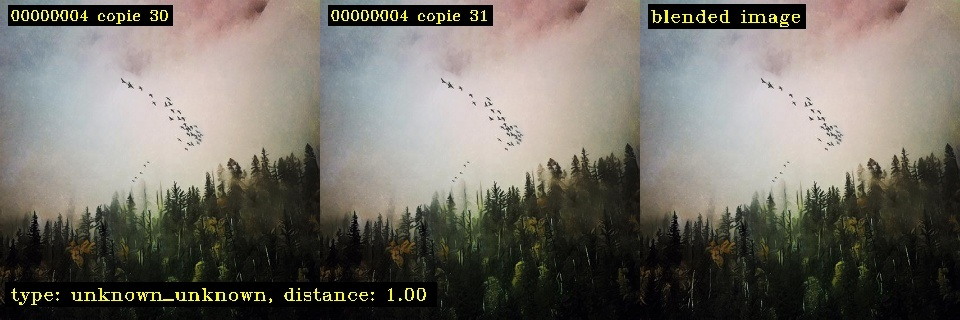
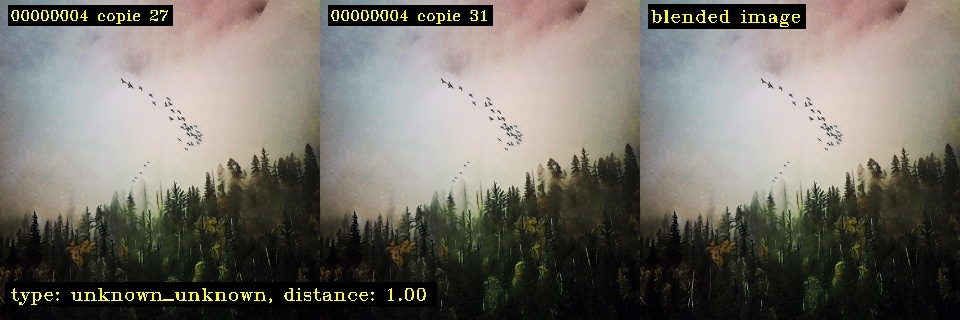
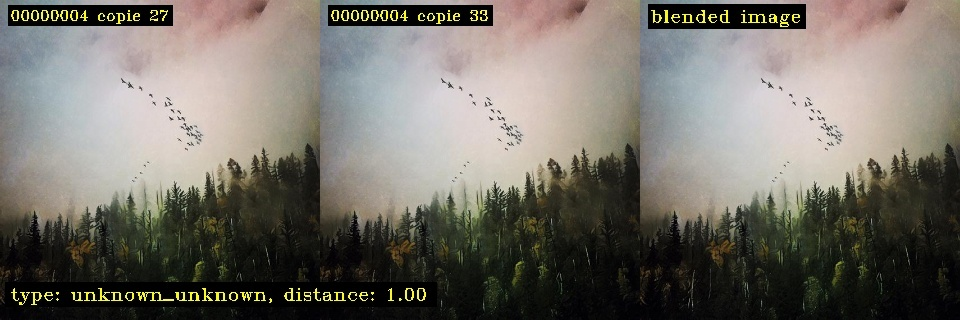
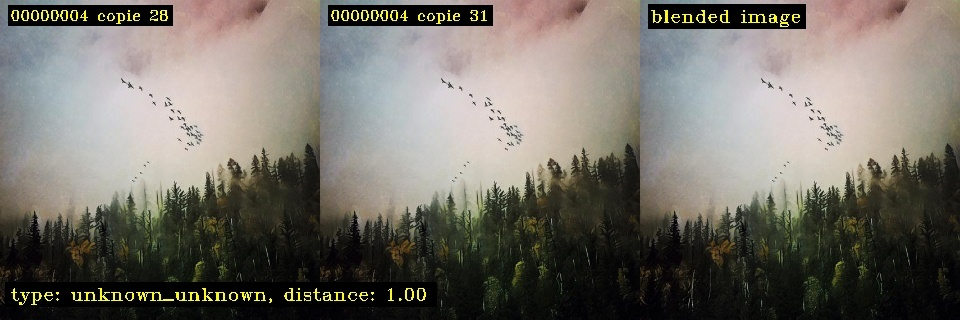
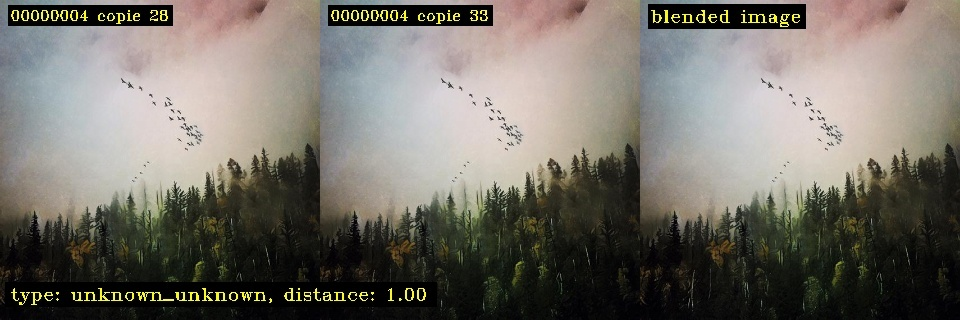
...
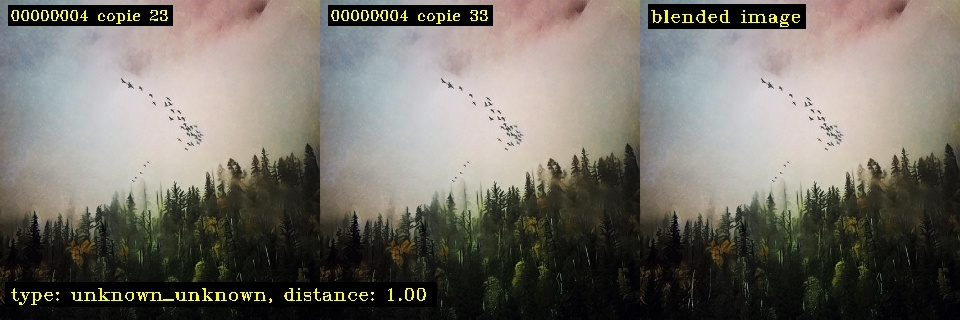
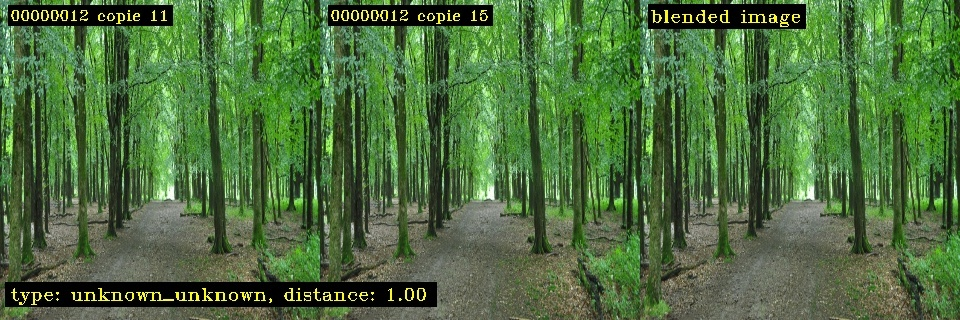
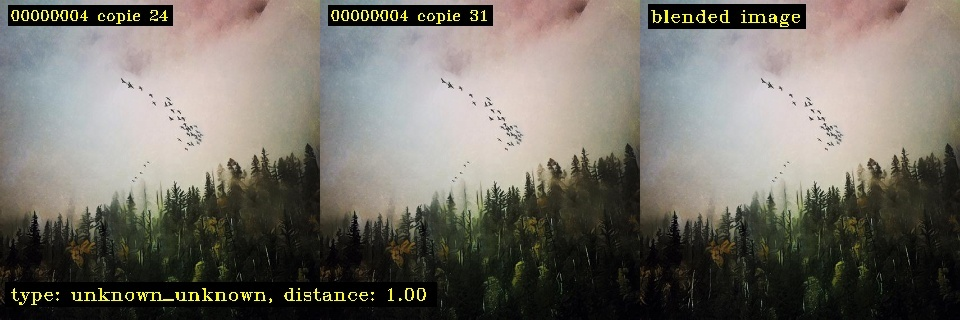
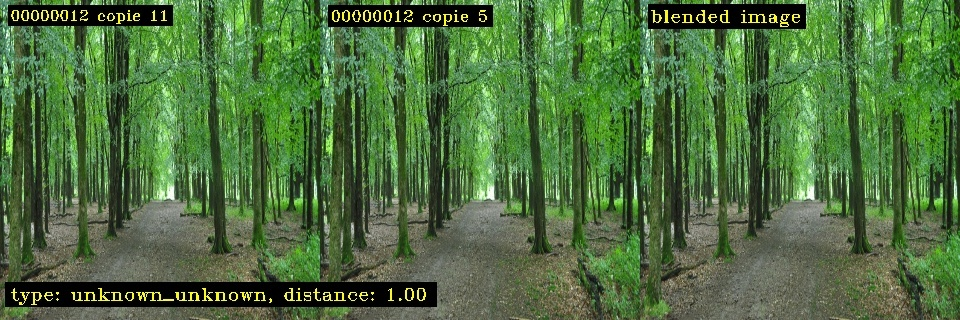
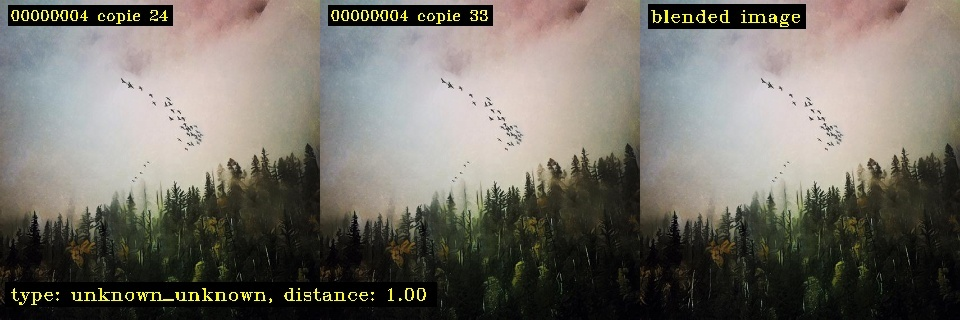

In [19]:
HTML('similarity.html')

## Identifier les images les plus sombres

100%|██████████| 20/20 [00:00<00:00, 32.13it/s]


Stored mean statistics view in  ./mean.html



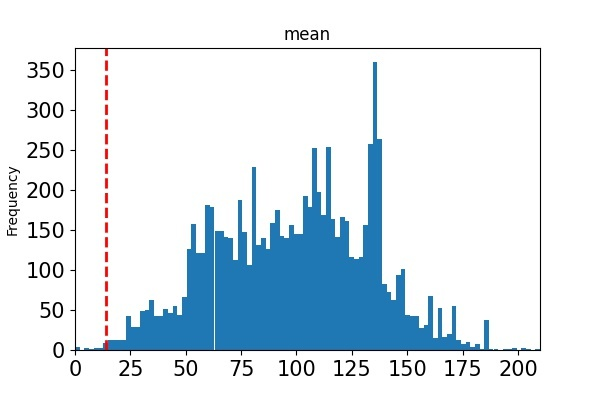
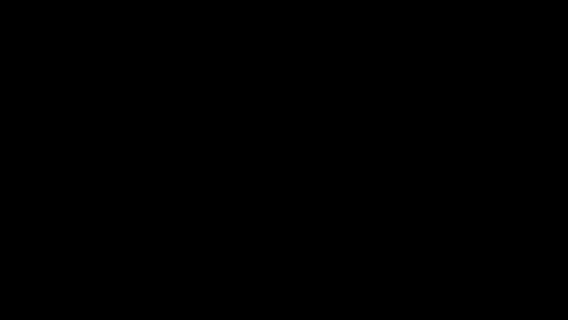
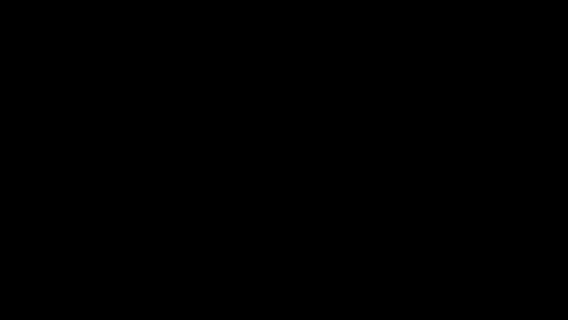
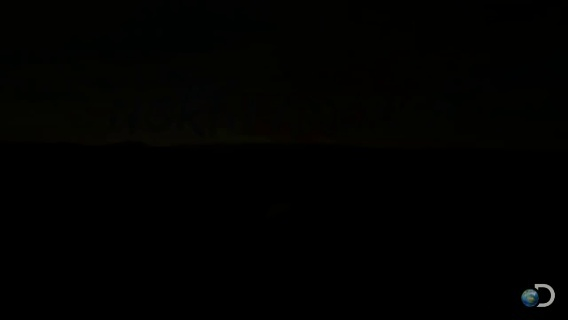
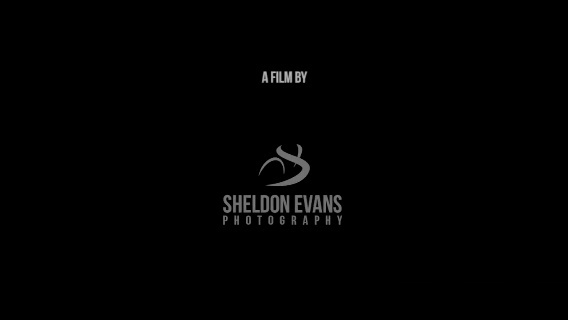
...
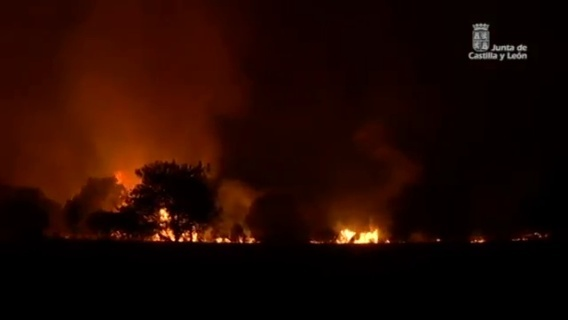
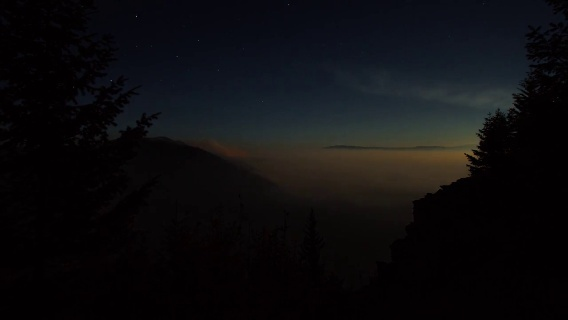
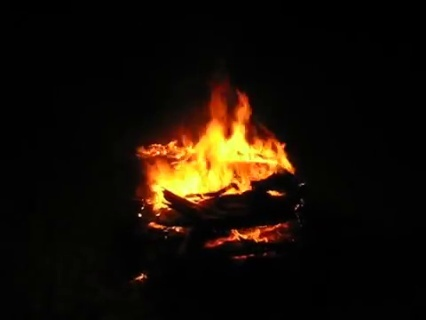
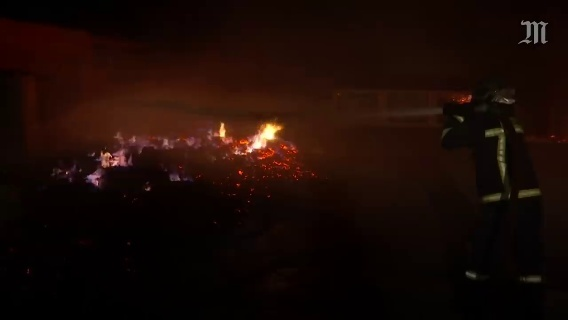

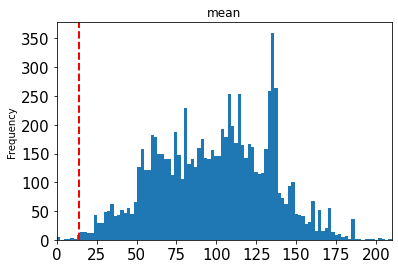

In [23]:
fastdup.create_stats_gallery('out',save_path='.', num_images=20, metric='mean',get_label_func=lambda x: x.split('/')[-2])
HTML('./mean.html')

## Identifier les images les plus claires

100%|██████████| 20/20 [00:00<00:00, 20.31it/s]


Stored mean statistics view in  ./mean.html



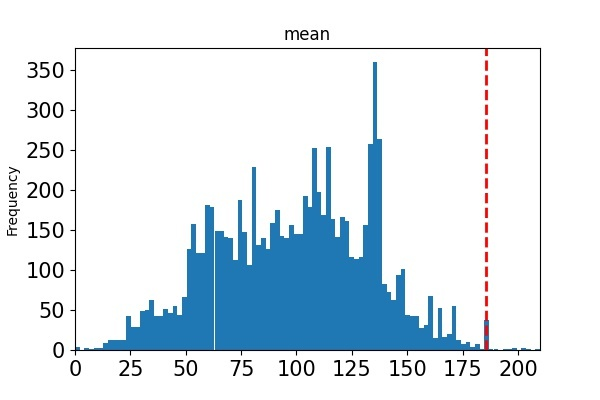
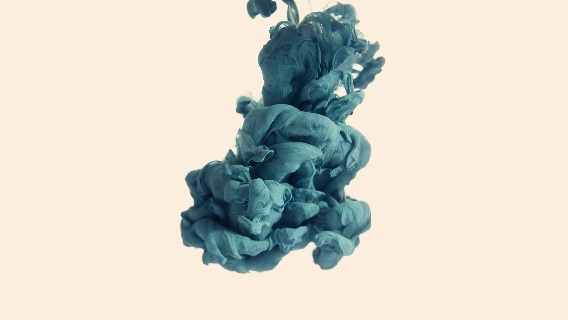
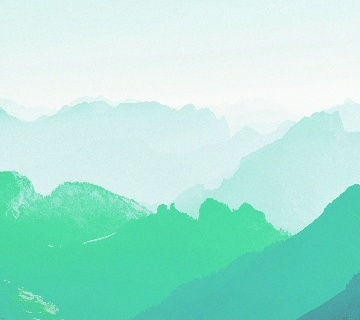
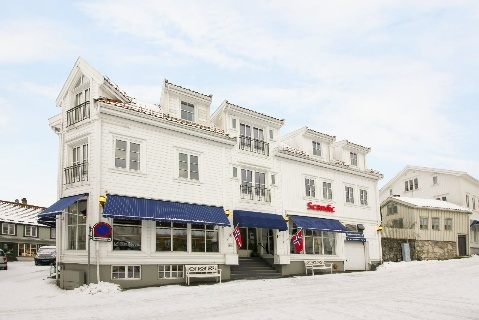
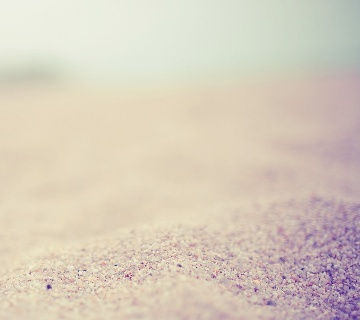
...
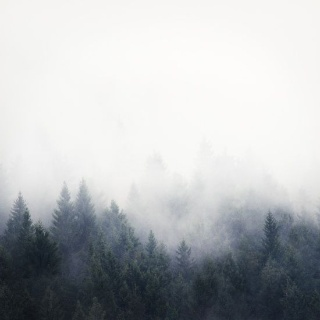
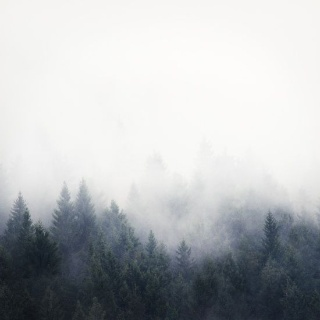
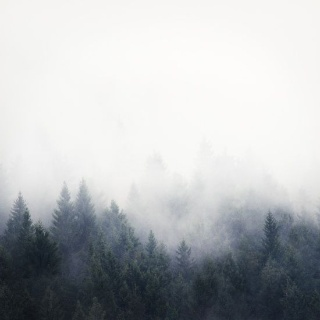
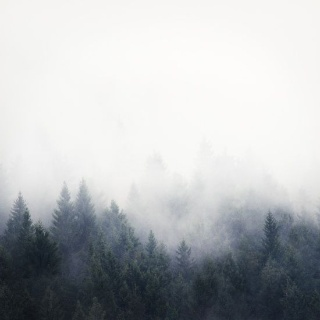

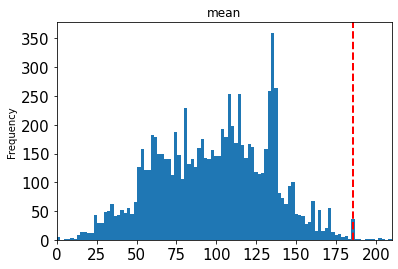

In [22]:
fastdup.create_stats_gallery('out',save_path='.', num_images=20, metric='mean',descending = True, get_label_func=lambda x: x.split('/')[-2])
HTML('mean.html')

## Identifier les images floutées

100%|██████████| 20/20 [00:00<00:00, 51.81it/s]


Stored blur statistics view in  ./blur.html



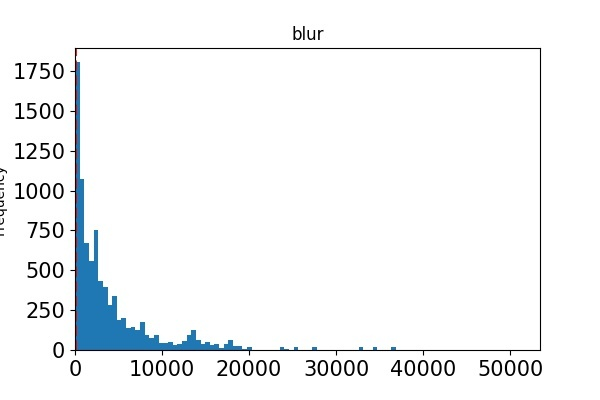
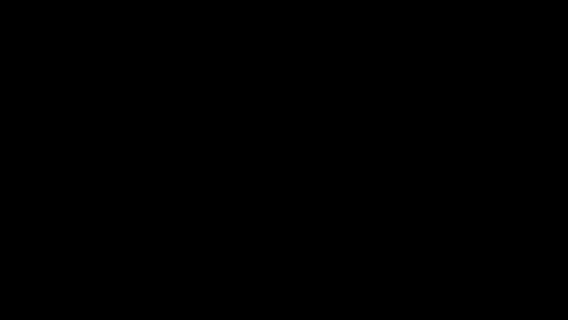
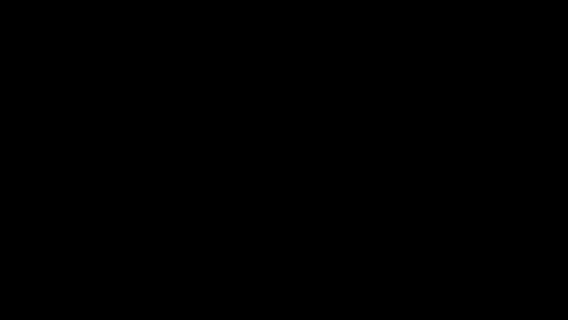
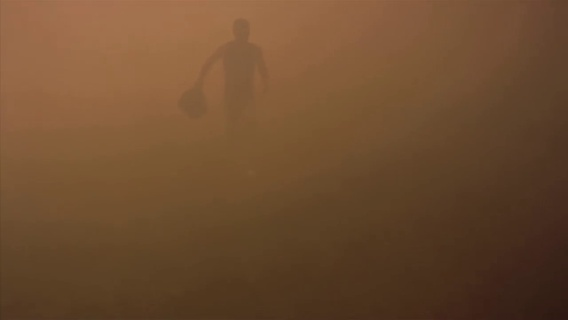
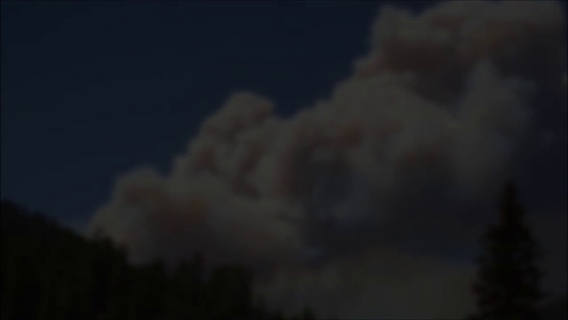
...
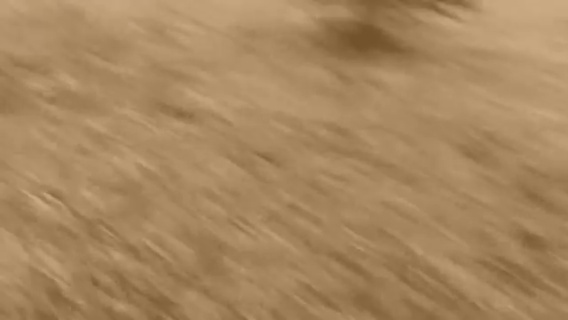
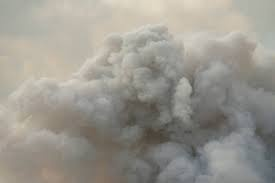
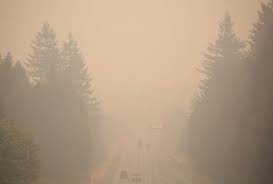
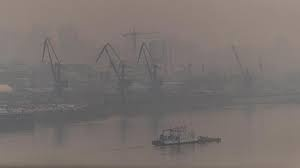

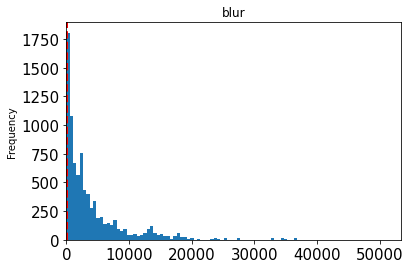

In [21]:
fastdup.create_stats_gallery('out',save_path='.', num_images=20, metric='blur',descending = False, get_label_func=lambda x: x.split('/')[-2])
HTML('blur.html')

## Identifier les problèmes dans les labels

100%|██████████| 10/10 [00:00<00:00, 12.07it/s]

Stored similar images view in  ./topk_similarity.html



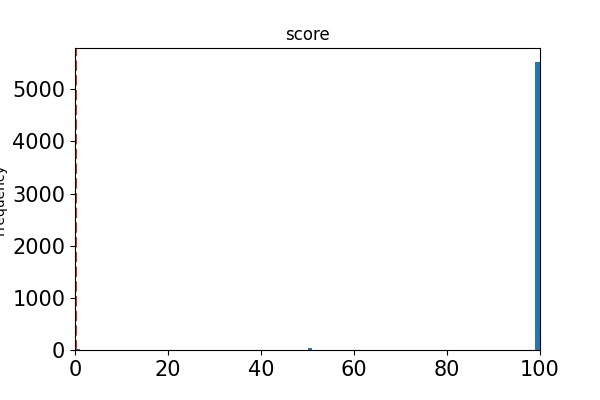
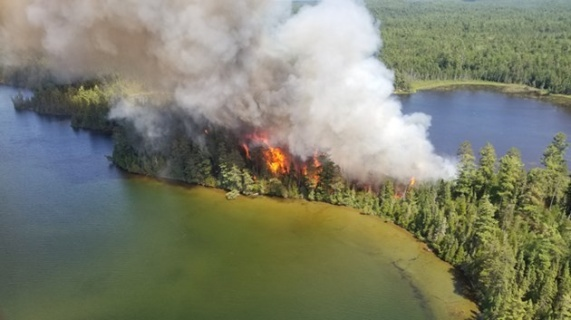
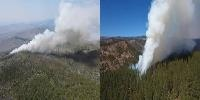
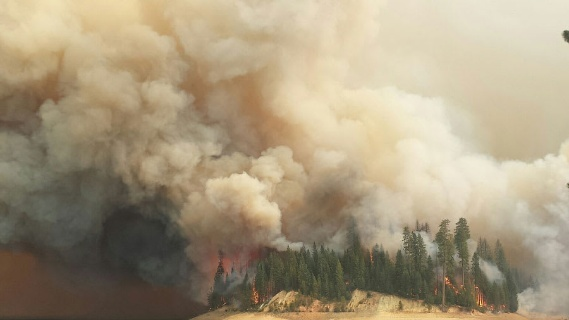
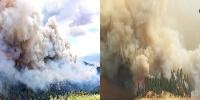
...
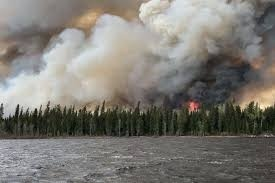
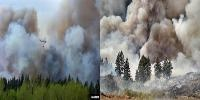
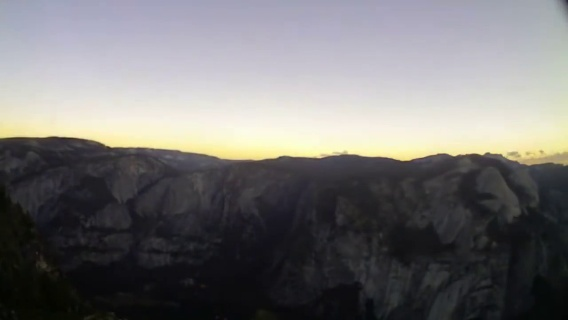
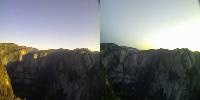

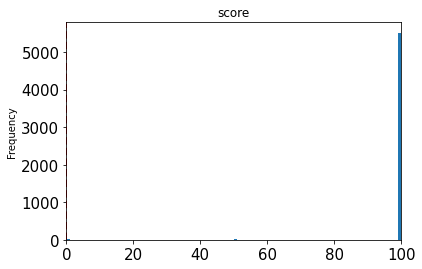

In [24]:
df2 = fastdup.create_similarity_gallery('out',save_path='.', num_images=10, get_label_func=lambda x: x.split('/')[-2], slice='label_score' )
HTML('topk_similarity.html')

## Identifier les images qui sont similaires à un seuil de 0.92%

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
On Jupyter notebook running on large datasets, there may be delay getting the console output
A recommended way to fixing this is to run: 
%pip install wurlitzer
%load_ext wurlitzer

Failed to read config file ./config.json
no_fire


100%|██████████| 20/20 [01:21<00:00,  4.09s/it]


Finished OK. Components are stored as image files ./components_[index].jpg
Stored components visual view in  ./components.html
Execution time in seconds 85.5



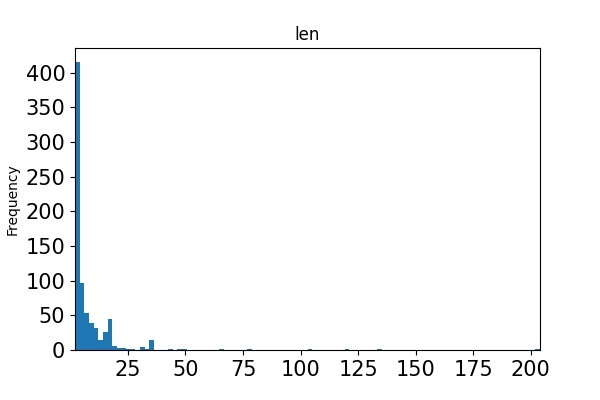
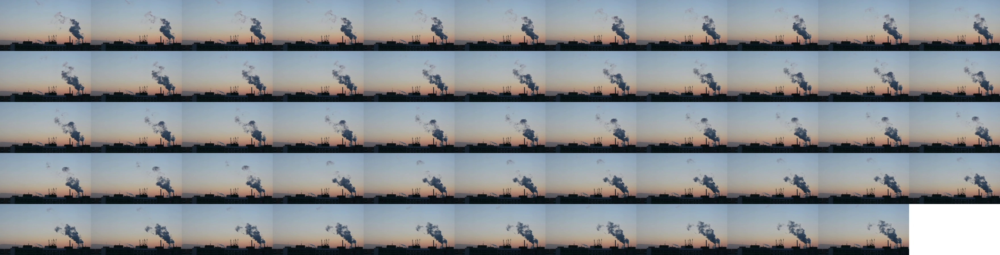
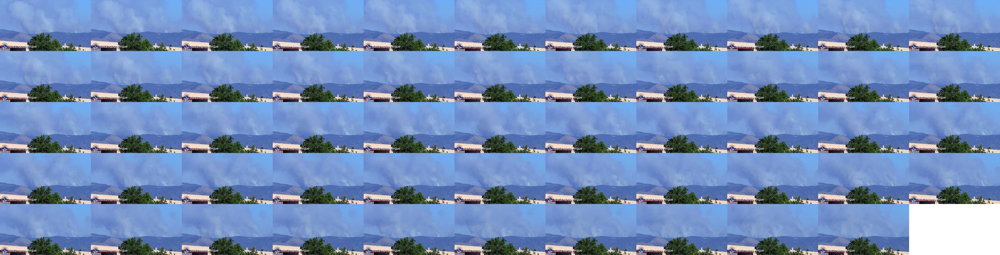
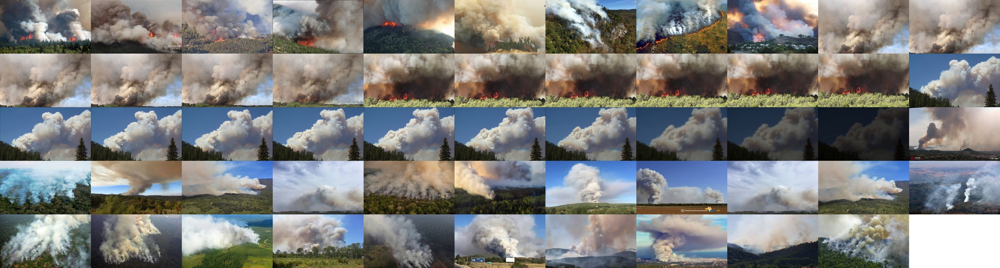
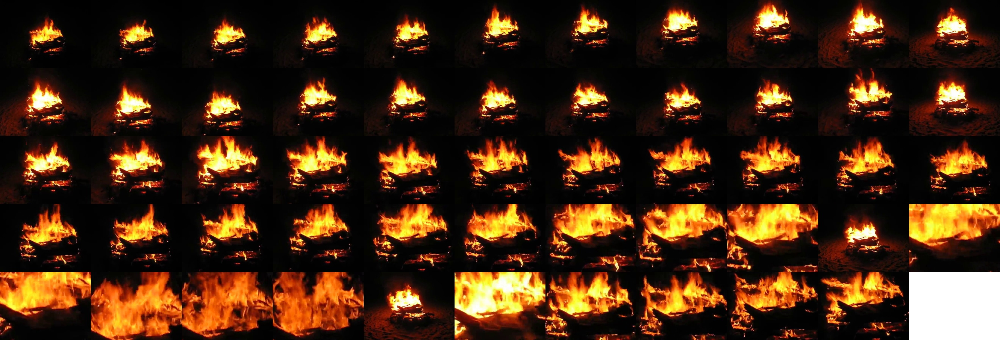
...
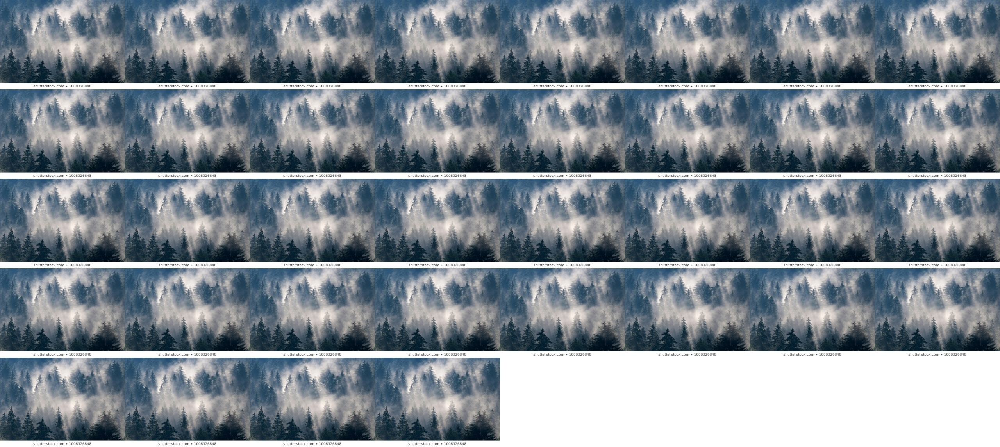
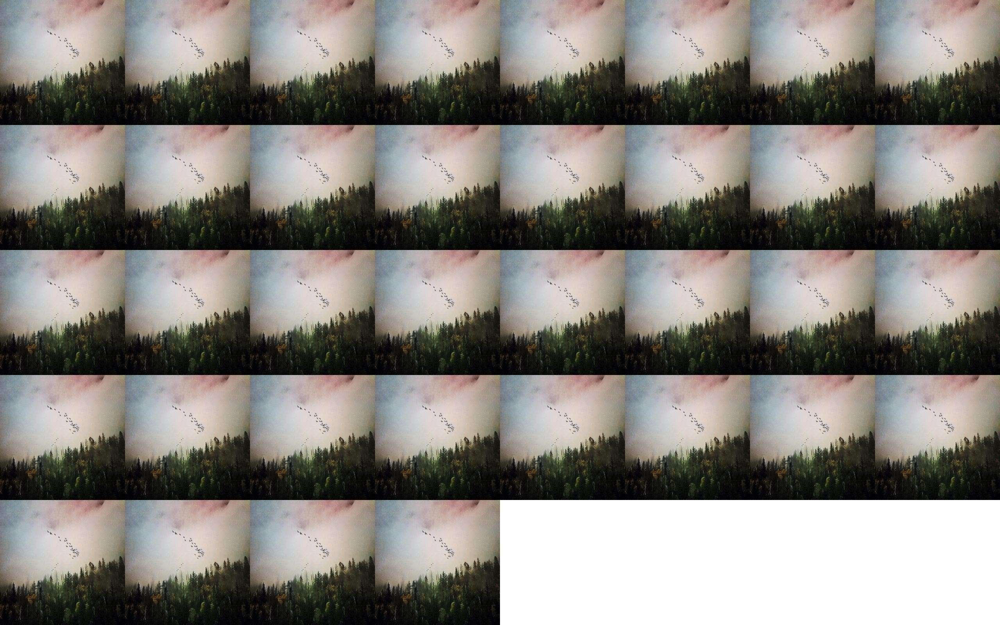
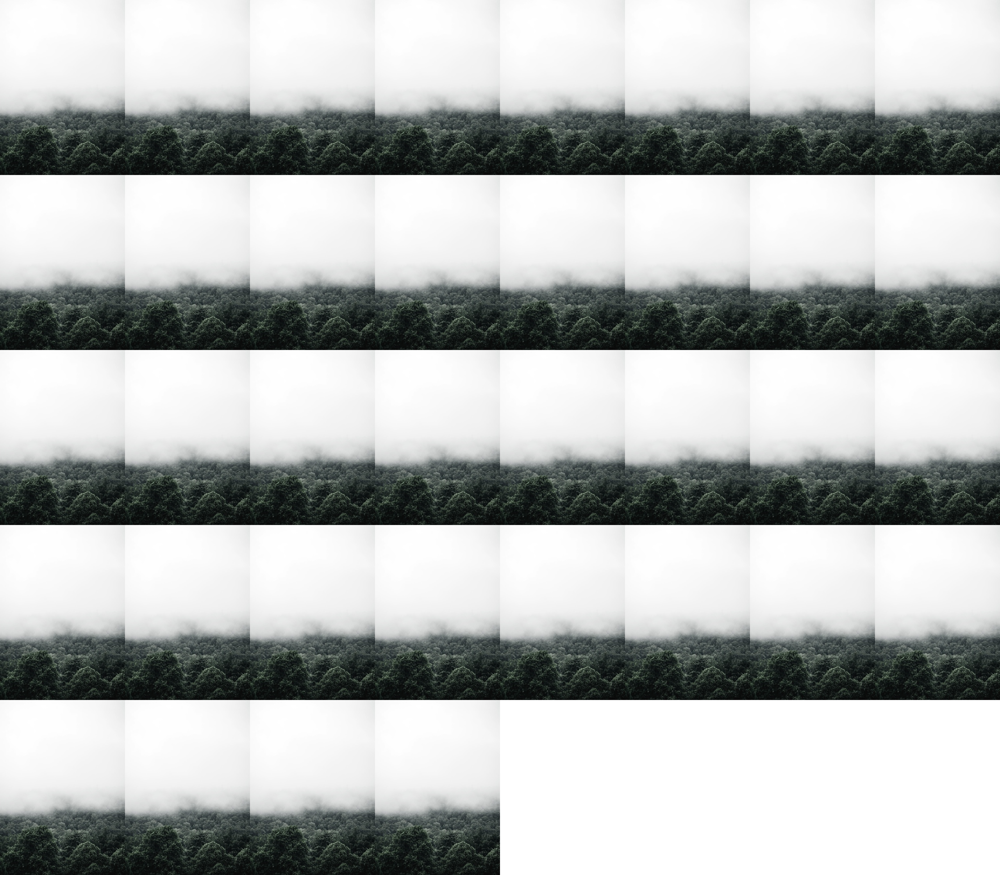
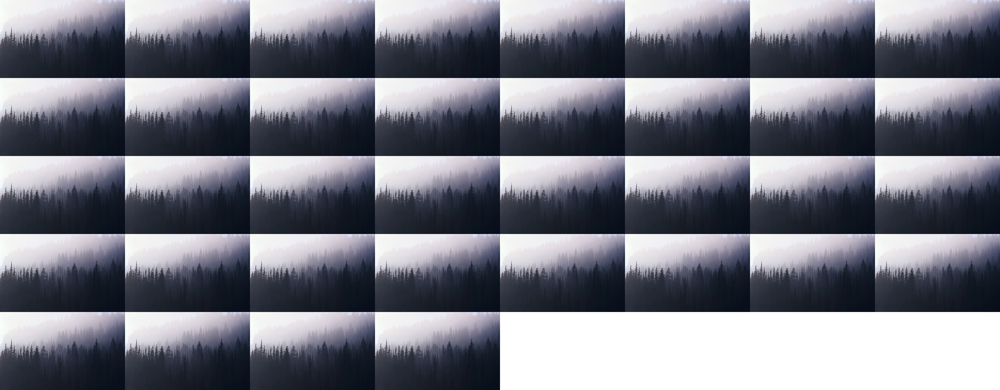

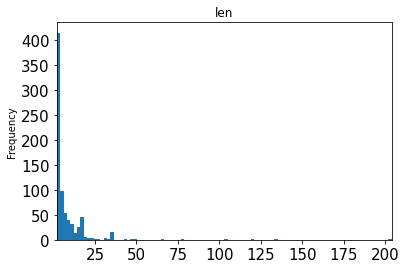

In [25]:
fastdup.run('/content/gdrive/MyDrive/Challenge1/db1', work_dir='out2', turi_param='ccthreshold=0.92')
fastdup.create_components_gallery('out2','.', get_label_func=lambda x: x.split('/')[-2])
HTML('components.html')

## Supprimer toutes les images qui sont semblables sauf une pour chaque groupe trouvé

In [ ]:
top_components = fastdup.find_top_components('out2')
top_components = top_components[top_components['len'] > 1]
fastdup.delete_components(top_components, to_delete=list(top_components['component_id'].unique()), how='one', dry_run=False)

## Supprimer le top 3% des images les plus floutées

In [ ]:
fastdup.delete_or_retag_stats_outliers('out2', metric='blur',how='delete', lower_percentile=0.03, dry_run=False)

## Suppression des images noires

In [ ]:
fastdup.delete_or_retag_stats_outliers('out2', metric='mean',how='delete', lower_threshold=12, dry_run=False)

## Suppression des images claires

In [ ]:
fastdup.delete_or_retag_stats_outliers('out2', metric='mean', how='delete', upper_threshold=200, dry_run=False)

## Supprimer les images avec mauvais label (seuil 80%)

In [ ]:
fastdup.delete_or_retag_stats_outliers(df2, metric='score', filename_col = 'from', lower_threshold=80, dry_run=False)

In [90]:
print('Tous les jeux de données ensembles après traitement')
print(f"Images feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db1/fire'))}")
print(f"Images début de feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db1/start_fire'))}")
print(f"Images pas de feu : {len(os.listdir('/content/gdrive/MyDrive/Challenge1/db1/no_fire'))}")

Tous les jeux de données ensembles après traitement
Images feu : 1053
Images début de feu : 566
Images pas de feu : 1466
